<a href="https://colab.research.google.com/github/AntonioBerecic/Underwater-images-enhancement/blob/main/Poboljsanje_podvodnih_fotografija_FINAL.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import cv2 as cv
import numpy as np
import matplotlib.pyplot as plt

In [ ]:
import gdown
file_id = "12W_kkblc2Vryb9zHQ6BfGQ_NKUfXYk13"
url = f"https://drive.google.com/uc?id={file_id}"
output = "raw-890.rar"
gdown.download(url, output, quiet=False)

file_id = "1cA-8CzajnVEL4feBRKdBxjEe6hwql6Z7"
url = f"https://drive.google.com/uc?id={file_id}"
output = "reference-890.rar"
gdown.download(url, output, quiet=False)


Downloading...
From (original): https://drive.google.com/uc?id=12W_kkblc2Vryb9zHQ6BfGQ_NKUfXYk13
From (redirected): https://drive.google.com/uc?id=12W_kkblc2Vryb9zHQ6BfGQ_NKUfXYk13&confirm=t&uuid=f90319e2-3841-4fc1-912c-7cbe107e01a1
To: /content/raw-890.rar
100%|██████████| 665M/665M [00:06<00:00, 98.9MB/s]
Downloading...
From (original): https://drive.google.com/uc?id=1cA-8CzajnVEL4feBRKdBxjEe6hwql6Z7
From (redirected): https://drive.google.com/uc?id=1cA-8CzajnVEL4feBRKdBxjEe6hwql6Z7&confirm=t&uuid=3ee93a2b-6412-46b0-8f68-7af830a4c3cd
To: /content/reference-890.rar
100%|██████████| 825M/825M [00:13<00:00, 62.0MB/s]


'reference-890.rar'

In [ ]:
!pip install rarfile

In [ ]:
import rarfile
import os

file_name = 'raw-890.rar'
extracted_folder = 'extracted_raw_files'
password = '1234567'

if os.path.exists(file_name):
    os.makedirs(extracted_folder, exist_ok=True)
    try:
        with rarfile.RarFile(file_name, 'r') as rf:
            rf.setpassword(password)
            rf.extractall(path=extracted_folder)
        print(f"File '{file_name}' extracted to '{extracted_folder}'")
    except rarfile.Error as e:
        print(f"Error extracting RAR file: {e}")
else:
    print(f"File '{file_name}' not found. Please make sure the file is in the correct directory.")

File 'raw-890.rar' extracted to 'extracted_raw_files'


In [ ]:
import rarfile
import os

file_name = 'reference-890.rar'
extracted_folder = 'extracted_reference_files'
password = '8901234'

if os.path.exists(file_name):
    os.makedirs(extracted_folder, exist_ok=True)
    try:
        with rarfile.RarFile(file_name, 'r') as rf:
            rf.setpassword(password)
            rf.extractall(path=extracted_folder)
        print(f"File '{file_name}' extracted to '{extracted_folder}'")
    except rarfile.Error as e:
        print(f"Error extracting RAR file: {e}")
else:
    print(f"File '{file_name}' not found. Please make sure the file is in the correct directory.")

File 'reference-890.rar' extracted to 'extracted_reference_files'


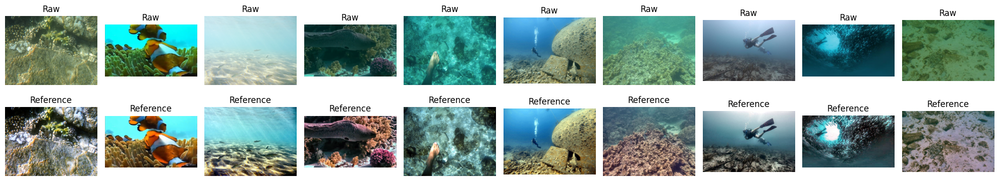

In [ ]:
import os
import random
import matplotlib.pyplot as plt
import cv2

raw_folder = 'extracted_raw_files/raw-890'
reference_folder = 'extracted_reference_files/reference-890'

if os.path.exists(raw_folder) and os.path.exists(reference_folder):
    raw_files = [f for f in os.listdir(raw_folder) if os.path.isfile(os.path.join(raw_folder, f))]
    reference_files = [f for f in os.listdir(reference_folder) if os.path.isfile(os.path.join(reference_folder, f))]

    # Create dictionaries mapping base filenames to full filenames
    raw_file_map = {os.path.splitext(f)[0]: f for f in raw_files}
    reference_file_map = {os.path.splitext(f)[0]: f for f in reference_files}

    # Find common base names between raw and reference files
    common_base_names = list(raw_file_map.keys() & reference_file_map.keys())

    if len(common_base_names) >= 10:
        # Select 10 random common base names
        selected_base_names = random.sample(common_base_names, 10)

        # Get the full filenames for the selected base names
        selected_raw_files = [raw_file_map[base_name] for base_name in selected_base_names]
        selected_reference_files = [reference_file_map[base_name] for base_name in selected_base_names]

        # Display the selected images in a 2x10 grid
        fig, axes = plt.subplots(2, 10, figsize=(20, 4))
        axes = axes.flatten()

        for i in range(10):
            raw_img_path = os.path.join(raw_folder, selected_raw_files[i])
            ref_img_path = os.path.join(reference_folder, selected_reference_files[i])

            raw_img = cv2.imread(raw_img_path)
            ref_img = cv2.imread(ref_img_path)

            # Display raw image
            axes[i].imshow(cv2.cvtColor(raw_img, cv2.COLOR_BGR2RGB))
            axes[i].set_title("Raw")
            axes[i].axis('off')

            # Display reference image
            axes[i+10].imshow(cv2.cvtColor(ref_img, cv2.COLOR_BGR2RGB))
            axes[i+10].set_title("Reference")
            axes[i+10].axis('off')

        plt.tight_layout()
        plt.show()

    else:
        print(f"Not enough matching raw and reference files to select 10 pairs. Found {len(common_base_names)} matching pairs.")
else:
    print("Raw or reference folder not found. Please make sure the files were extracted correctly.")

In [ ]:
def dark_channel_prior_dehazing(image, patch_size=10, omega=0.50, t0=0.1):
    """
    Applies dehazing using the dark channel prior algorithm.

    Args:
        image: The input image (NumPy array) in BGR format.
        patch_size: The size of the local patch for dark channel calculation.
        omega: The amount of haze to remove (closer to 1 removes more haze).
        t0: Minimum allowed transmission map value.

    Returns:
        The dehazed image (NumPy array) in BGR format.
    """
    # Convert to float for calculations
    image_float = image.astype(np.float32) / 255.0

    # Calculate the dark channel
    min_channel = np.min(image_float, axis=2)
    kernel = cv2.getStructuringElement(cv2.MORPH_RECT, (patch_size, patch_size))
    dark_channel = cv2.erode(min_channel, kernel)

    # Estimate atmospheric light
    # Select the top 0.1% brightest pixels in the dark channel
    flat_dark_channel = dark_channel.flatten()
    flat_image = image_float.reshape(-1, 3)
    indices = np.argsort(flat_dark_channel)[::-1]
    top_indices = indices[:int(len(indices) * 0.001)]
    atmospheric_light = np.max(flat_image[top_indices], axis=0)

    # Estimate transmission map
    transmission = 1 - omega * dark_channel / atmospheric_light.max() # Use max of atmospheric light for simplicity
    transmission = np.maximum(transmission, t0)

    # Recover the scene radiance (dehazed image)
    # Ensure dimensions match for element-wise operations
    atmospheric_light_reshaped = atmospheric_light.reshape(1, 1, 3)
    transmission_reshaped = transmission[:, :, np.newaxis]

    dehazed_image = (image_float - atmospheric_light_reshaped) / transmission_reshaped + atmospheric_light_reshaped

    # Clip values to the valid range [0, 1] and convert back to uint8
    dehazed_image = np.clip(dehazed_image * 255, 0, 255).astype(np.uint8)

    return dehazed_image

In [ ]:
dehazed_images = []

for raw_file_name in selected_raw_files:
    raw_img_path = os.path.join(raw_folder, raw_file_name)
    raw_img = cv2.imread(raw_img_path)
    if raw_img is not None:
        dehazed_image = dark_channel_prior_dehazing(raw_img)
        dehazed_images.append(dehazed_image)
    else:
        print(f"Warning: Could not read image file {raw_img_path}")

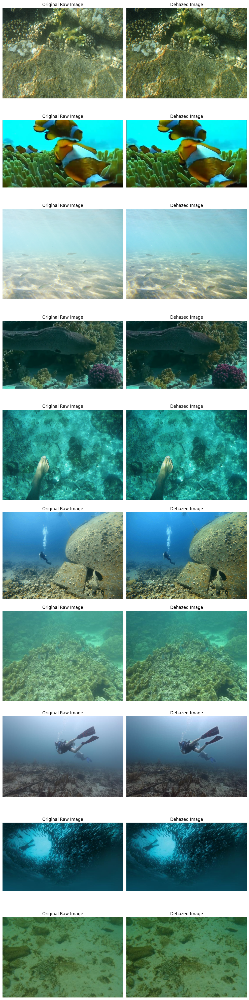

In [ ]:
num_images_to_display = 10
fig, axes = plt.subplots(num_images_to_display, 2, figsize=(10, num_images_to_display * 4))
axes = axes.flatten()

for i in range(num_images_to_display):
    # Display original raw image
    raw_img_path = os.path.join(raw_folder, selected_raw_files[i])
    raw_img = cv2.imread(raw_img_path)
    axes[i * 2].imshow(cv2.cvtColor(raw_img, cv2.COLOR_BGR2RGB))
    axes[i * 2].set_title("Original Raw Image")
    axes[i * 2].axis('off')

    # Display dehazed image
    axes[i * 2 + 1].imshow(cv2.cvtColor(dehazed_images[i], cv2.COLOR_BGR2RGB))
    axes[i * 2 + 1].set_title("Dehazed Image")
    axes[i * 2 + 1].axis('off')

plt.tight_layout()
plt.show()

In [ ]:
def white_balance(image):
    """
    Applies white balance by stretching the intensity range of each color channel.

    Args:
        image: The input image (NumPy array) in BGR format.

    Returns:
        The white-balanced image (NumPy array) in BGR format.
    """
    # Convert image to float for calculations
    image_float = image.astype(np.float32)

    # Split channels
    b, g, r = cv2.split(image_float)

    # Stretch each channel's intensity range
    b_stretched = cv2.normalize(b, None, 0, 255, cv2.NORM_MINMAX)
    g_stretched = cv2.normalize(g, None, 0, 255, cv2.NORM_MINMAX)
    r_stretched = cv2.normalize(r, None, 0, 255, cv2.NORM_MINMAX)

    # Merge channels and convert back to uint8
    white_balanced_image = cv2.merge([b_stretched, g_stretched, r_stretched])
    white_balanced_image = np.clip(white_balanced_image, 0, 255).astype(np.uint8)

    return white_balanced_image

In [ ]:
white_balanced_images = []

for dehazed_image in dehazed_images:
    white_balanced_img = white_balance(dehazed_image)
    white_balanced_images.append(white_balanced_img)

print("White balance applied to all sharpened images.")

White balance applied to all sharpened images.


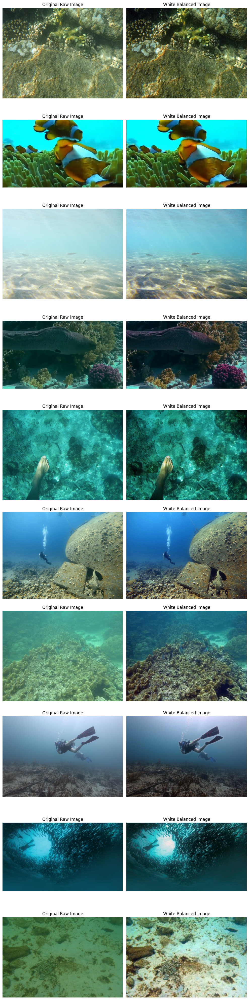

In [ ]:
num_images_to_display = 10
fig, axes = plt.subplots(num_images_to_display, 2, figsize=(10, num_images_to_display * 4))
axes = axes.flatten()

for i in range(num_images_to_display):
    # Display original raw image
    raw_img_path = os.path.join(raw_folder, selected_raw_files[i])
    raw_img = cv2.imread(raw_img_path)
    axes[i * 2].imshow(cv2.cvtColor(raw_img, cv2.COLOR_BGR2RGB))
    axes[i * 2].set_title("Original Raw Image")
    axes[i * 2].axis('off')

    # Display white-balanced image
    axes[i * 2 + 1].imshow(cv2.cvtColor(white_balanced_images[i], cv2.COLOR_BGR2RGB))
    axes[i * 2 + 1].set_title("White Balanced Image")
    axes[i * 2 + 1].axis('off')

plt.tight_layout()
plt.show()

In [ ]:
def color_scale(image):
    """
    Applies a more aggressive color scaling to compensate for underwater
    color absorption by boosting red and reducing blue/green.

    Args:
        image: The input image (NumPy array) in BGR format.

    Returns:
        The color-corrected image (NumPy array) in BGR format.
    """
    # Convert image to float for calculations
    image_float = image.astype(np.float32)

    # Boost red, cut green and blue
    scale_blue = 0.85
    scale_green = 0.90
    scale_red = 1.05

    # Apply scaling to each channel
    b, g, r = cv2.split(image_float)
    b_scaled = b * scale_blue
    g_scaled = g * scale_green
    r_scaled = r * scale_red

    # Merge channels and clip values to the valid range [0, 255]
    color_corrected_image = cv2.merge([b_scaled, g_scaled, r_scaled])
    color_corrected_image = np.clip(color_corrected_image, 0, 255).astype(np.uint8)

    return color_corrected_image

In [ ]:
color_corrected_images = []

for white_balanced_img in white_balanced_images:
    color_corrected_img = color_scale(white_balanced_img)
    color_corrected_images.append(color_corrected_img)

print("Color correction applied to all images.")

Color correction applied to all images.


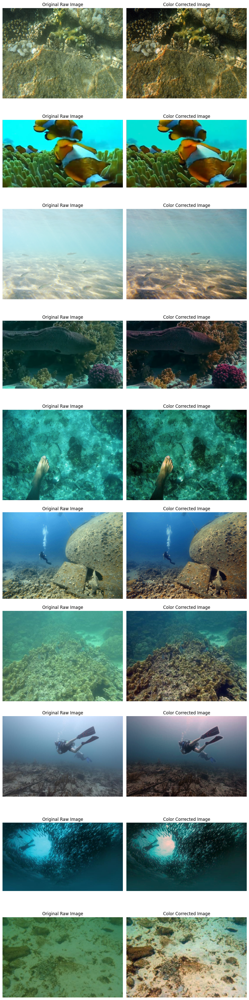

In [ ]:
num_images_to_display = 10
fig, axes = plt.subplots(num_images_to_display, 2, figsize=(10, num_images_to_display * 4))
axes = axes.flatten()

for i in range(num_images_to_display):
    # Display original raw image
    raw_img_path = os.path.join(raw_folder, selected_raw_files[i])
    raw_img = cv2.imread(raw_img_path)
    axes[i * 2].imshow(cv2.cvtColor(raw_img, cv2.COLOR_BGR2RGB))
    axes[i * 2].set_title("Original Raw Image")
    axes[i * 2].axis('off')

    # Display color-corrected image
    axes[i * 2 + 1].imshow(cv2.cvtColor(color_corrected_images[i], cv2.COLOR_BGR2RGB))
    axes[i * 2 + 1].set_title("Color Corrected Image")
    axes[i * 2 + 1].axis('off')

plt.tight_layout()
plt.show()

In [ ]:
def enhance_contrast_histogram_equalization(image, clip_limit=2.0, tile_grid_size=(8, 8)):
    """
    Applies Contrast Limited Adaptive Histogram Equalization (CLAHE) to enhance contrast.

    Args:
        image: The input image (NumPy array) in BGR format.
        clip_limit: Threshold for contrast limiting.
        tile_grid_size: Size of the grid for histogram equalization. Input image will be divided into
                        equal sized rectangular regions.

    Returns:
        The contrast-enhanced image (NumPy array) in BGR format.
    """
    # Convert the image to HSV color space
    hsv_image = cv2.cvtColor(image, cv2.COLOR_BGR2HSV)

    # Split the HSV image into channels
    h, s, v = cv2.split(hsv_image)

    # Create a CLAHE object
    clahe = cv2.createCLAHE(clipLimit=clip_limit, tileGridSize=tile_grid_size)

    # Apply CLAHE to the V channel
    clahe_v = clahe.apply(v)

    # Merge the CLAHE V channel with the original H and S channels
    hsv_merged = cv2.merge([h, s, clahe_v])

    # Convert the HSV image back to BGR
    contrast_enhanced_image = cv2.cvtColor(hsv_merged, cv2.COLOR_HSV2BGR)

    return contrast_enhanced_image

In [ ]:
contrast_enhanced_images = []

for color_corrected_img in color_corrected_images:
    contrast_enhanced_img = enhance_contrast_histogram_equalization(color_corrected_img)
    contrast_enhanced_images.append(contrast_enhanced_img)

print("Histogram equalization applied to all sharpened images.")

Histogram equalization applied to all sharpened images.


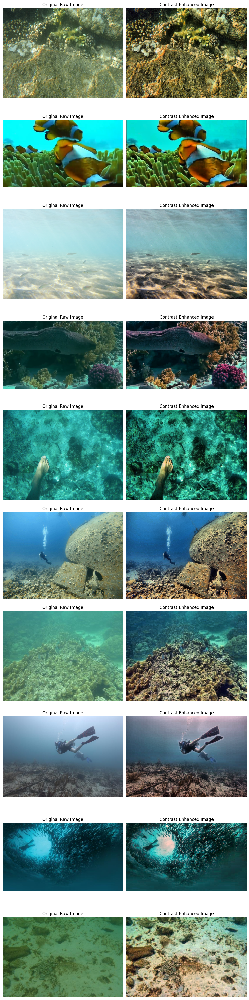

In [ ]:
num_images_to_display = 10
fig, axes = plt.subplots(num_images_to_display, 2, figsize=(10, num_images_to_display * 4))
axes = axes.flatten()

for i in range(num_images_to_display):
    # Display original raw image
    raw_img_path = os.path.join(raw_folder, selected_raw_files[i])
    raw_img = cv2.imread(raw_img_path)
    axes[i * 2].imshow(cv2.cvtColor(raw_img, cv2.COLOR_BGR2RGB))
    axes[i * 2].set_title("Original Raw Image")
    axes[i * 2].axis('off')

    # Display contrast-enhanced image
    axes[i * 2 + 1].imshow(cv2.cvtColor(contrast_enhanced_images[i], cv2.COLOR_BGR2RGB))
    axes[i * 2 + 1].set_title("Contrast Enhanced Image")
    axes[i * 2 + 1].axis('off')

plt.tight_layout()
plt.show()

In [ ]:
def unsharp_masking(image, kernel_size=(5, 5), amount=0.60):
    """
    Applies unsharp masking to an image.

    Args:
        image: The input image (NumPy array).
        kernel_size: The size of the Gaussian kernel for blurring.
        amount: The unsharp mask amount.

    Returns:
        The sharpened image (NumPy array).
    """
    blurred = cv2.GaussianBlur(image, kernel_size, 0)
    sharpened = cv2.addWeighted(image, 1.0 + amount, blurred, -amount, 0)
    return np.clip(sharpened, 0, 255).astype(np.uint8)

In [ ]:
sharpened_images = []

for contrast_enhanced_img in contrast_enhanced_images:
    sharpened_image = unsharp_masking(contrast_enhanced_img)
    sharpened_images.append(sharpened_image)

print("Histogram equalization applied to all sharpened images.")


Histogram equalization applied to all sharpened images.


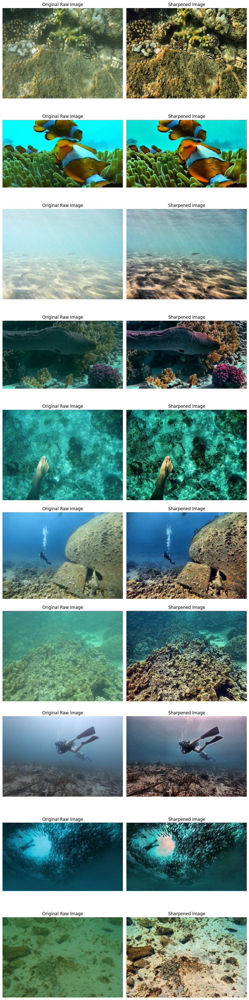

In [ ]:
num_images_to_display = 10
fig, axes = plt.subplots(num_images_to_display, 2, figsize=(10, num_images_to_display * 4))
axes = axes.flatten()

for i in range(num_images_to_display):
    # Display original raw image
    axes[i * 2].imshow(cv2.cvtColor(cv2.imread(os.path.join(raw_folder, selected_raw_files[i])), cv2.COLOR_BGR2RGB))
    axes[i * 2].set_title("Original Raw Image")
    axes[i * 2].axis('off')

    # Display sharpened image
    axes[i * 2 + 1].imshow(cv2.cvtColor(sharpened_images[i], cv2.COLOR_BGR2RGB))
    axes[i * 2 + 1].set_title("Sharpened Image")
    axes[i * 2 + 1].axis('off')

plt.tight_layout()
plt.show()

In [ ]:
from skimage.metrics import peak_signal_noise_ratio as psnr
from skimage.metrics import structural_similarity as ssim
import numpy as np
import cv2
import os

psnr_scores = []
ssim_scores = []

# Ensure we only evaluate the images that were successfully processed and have a corresponding reference
num_processed_images = len(sharpened_images)

print("Evaluation Results:")

for i in range(num_processed_images):
    # Load the original raw image corresponding to the processed image to find the reference
    raw_file_name = selected_raw_files[i]
    raw_img_path = os.path.join(raw_folder, raw_file_name)
    # Find the corresponding reference file using the base name
    base_name = os.path.splitext(raw_file_name)[0]

    if base_name in reference_file_map:
        ref_file_name = reference_file_map[base_name]
        ref_img_path = os.path.join(reference_folder, ref_file_name)
        ref_img = cv2.imread(ref_img_path)
        enhanced_img = sharpened_images[i]

        if ref_img is not None:
            if ref_img.shape == enhanced_img.shape:
                # Convert images to grayscale for SSIM calculation (SSIM is typically calculated on grayscale)
                ref_gray = cv2.cvtColor(ref_img, cv2.COLOR_BGR2GRAY)
                enhanced_gray = cv2.cvtColor(enhanced_img, cv2.COLOR_BGR2GRAY)

                # Calculate PSNR
                psnr_score = psnr(ref_img, enhanced_img, data_range=255)
                psnr_scores.append(psnr_score)

                # Calculate SSIM
                ssim_score = ssim(ref_gray, enhanced_gray, data_range=255)
                ssim_scores.append(ssim_score)

                print(f"  Image {i+1} ({raw_file_name} vs {ref_file_name}): PSNR = {psnr_score:.2f}, SSIM = {ssim_score:.4f}")

            else:
                print(f"Warning: Reference and enhanced image shape mismatch for {raw_file_name}. Skipping evaluation.")
        else:
            print(f"Warning: Could not read reference image file for {raw_file_name}. Skipping evaluation.")
    else:
        print(f"Warning: No corresponding reference image found for {raw_file_name}. Skipping evaluation.")


if psnr_scores and ssim_scores:
    average_psnr = np.mean(psnr_scores)
    average_ssim = np.mean(ssim_scores)

    print(f"\nAverage PSNR across {len(psnr_scores)} images: {average_psnr:.2f}")
    print(f"Average SSIM across {len(ssim_scores)} images: {average_ssim:.4f}")
else:
    print("No images were successfully evaluated for PSNR and SSIM.")

Evaluation Results:
  Image 1 (271_img_.png vs 271_img_.png): PSNR = 15.22, SSIM = 0.8508
  Image 2 (758.png vs 758.png): PSNR = 15.29, SSIM = 0.8925
  Image 3 (479_img_.png vs 479_img_.png): PSNR = 19.71, SSIM = 0.9286
  Image 4 (2629.png vs 2629.png): PSNR = 18.20, SSIM = 0.8959
  Image 5 (652_img_.png vs 652_img_.png): PSNR = 15.21, SSIM = 0.8498
  Image 6 (800_img_.png vs 800_img_.png): PSNR = 17.94, SSIM = 0.8286
  Image 7 (606_img_.png vs 606_img_.png): PSNR = 19.16, SSIM = 0.8928
  Image 8 (453_img_.png vs 453_img_.png): PSNR = 19.28, SSIM = 0.9137
  Image 9 (487_img_.png vs 487_img_.png): PSNR = 20.33, SSIM = 0.9381
  Image 10 (576_img_.png vs 576_img_.png): PSNR = 17.48, SSIM = 0.8108

Average PSNR across 10 images: 17.78
Average SSIM across 10 images: 0.8802


In [ ]:
from skimage.metrics import peak_signal_noise_ratio as psnr
from skimage.metrics import structural_similarity as ssim
import numpy as np
import cv2
import os

psnr_raw_ref = []
ssim_raw_ref = []

# Ensure we only evaluate the images that have both a raw and a reference version
# We can iterate through the selected_raw_files and find the corresponding reference
num_selected_images = len(selected_raw_files)

print("Evaluation Results (Raw vs Reference):")

for i in range(num_selected_images):
    raw_file_name = selected_raw_files[i]
    raw_img_path = os.path.join(raw_folder, raw_file_name)
    raw_img = cv2.imread(raw_img_path)

    # Find the corresponding reference file using the base name
    base_name = os.path.splitext(raw_file_name)[0]
    if base_name in reference_file_map:
        ref_file_name = reference_file_map[base_name]
        ref_img_path = os.path.join(reference_folder, ref_file_name)
        ref_img = cv2.imread(ref_img_path)

        if raw_img is not None and ref_img is not None:
            # Ensure both images have the same dimensions for comparison
            if raw_img.shape == ref_img.shape:
                # Convert images to grayscale for SSIM
                raw_gray = cv2.cvtColor(raw_img, cv2.COLOR_BGR2GRAY)
                ref_gray = cv2.cvtColor(ref_img, cv2.COLOR_BGR2GRAY)

                # Calculate PSNR
                psnr_score = psnr(raw_img, ref_img, data_range=255)
                psnr_raw_ref.append(psnr_score)

                # Calculate SSIM
                ssim_score = ssim(raw_gray, ref_gray, data_range=255)
                ssim_raw_ref.append(ssim_score)

                print(f"  Image {i+1} ({raw_file_name} vs {ref_file_name}): PSNR = {psnr_score:.2f}, SSIM = {ssim_score:.4f}")


            else:
                print(f"Warning: Raw and reference image shape mismatch for {raw_file_name}. Skipping evaluation.")
        else:
            print(f"Warning: Could not read raw or reference image file for {raw_file_name}. Skipping evaluation.")
    else:
        print(f"Warning: No corresponding reference image found for {raw_file_name}. Skipping evaluation.")


if psnr_raw_ref and ssim_raw_ref:
    average_psnr_raw_ref = np.mean(psnr_raw_ref)
    average_ssim_raw_ref = np.mean(ssim_raw_ref)

    print(f"\nAverage PSNR between Raw and Reference images across {len(psnr_raw_ref)} pairs: {average_psnr_raw_ref:.2f}")
    print(f"Average SSIM between Raw and Reference images across {len(ssim_raw_ref)} pairs: {average_ssim_raw_ref:.4f}")
else:
    print("No raw and reference image pairs were successfully evaluated.")

Evaluation Results (Raw vs Reference):
  Image 1 (271_img_.png vs 271_img_.png): PSNR = 17.02, SSIM = 0.7645
  Image 2 (758.png vs 758.png): PSNR = 15.53, SSIM = 0.9697
  Image 3 (479_img_.png vs 479_img_.png): PSNR = 12.63, SSIM = 0.6887
  Image 4 (2629.png vs 2629.png): PSNR = 14.57, SSIM = 0.7572
  Image 5 (652_img_.png vs 652_img_.png): PSNR = 16.30, SSIM = 0.8626
  Image 6 (800_img_.png vs 800_img_.png): PSNR = 23.70, SSIM = 0.9570
  Image 7 (606_img_.png vs 606_img_.png): PSNR = 17.05, SSIM = 0.7851
  Image 8 (453_img_.png vs 453_img_.png): PSNR = 21.22, SSIM = 0.8558
  Image 9 (487_img_.png vs 487_img_.png): PSNR = 16.17, SSIM = 0.7408
  Image 10 (576_img_.png vs 576_img_.png): PSNR = 15.74, SSIM = 0.7809

Average PSNR between Raw and Reference images across 10 pairs: 16.99
Average SSIM between Raw and Reference images across 10 pairs: 0.8162


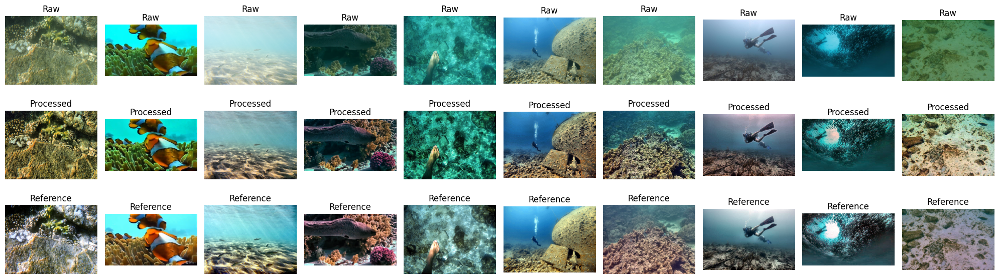

In [ ]:
num_images_to_display = 10
fig, axes = plt.subplots(3, num_images_to_display, figsize=(20, 6))

# Ensure we only display images that were successfully dehazed and have a corresponding reference
num_dehazed_images = len(dehazed_images)
num_to_display = min(num_images_to_display, num_dehazed_images)
# Also need to ensure we have enough raw and reference files
num_raw_files = len(selected_raw_files)
num_reference_files = len(selected_reference_files) # Assuming selected_reference_files is available from previous steps
num_to_display = min(num_to_display, num_raw_files, num_reference_files)


for i in range(num_to_display):
    # Display original raw image in the first row
    raw_img_path = os.path.join(raw_folder, selected_raw_files[i])
    raw_img = cv2.imread(raw_img_path)
    if raw_img is not None:
        axes[0, i].imshow(cv2.cvtColor(raw_img, cv2.COLOR_BGR2RGB))
        axes[0, i].set_title("Raw")
        axes[0, i].axis('off')
    else:
        print(f"Warning: Could not read original raw image file {selected_raw_files[i]}. Skipping display of raw.")
        axes[0, i].axis('off')


    # Display dehazed image in the second row
    axes[1, i].imshow(cv2.cvtColor(sharpened_images[i], cv2.COLOR_BGR2RGB))
    axes[1, i].set_title("Processed")
    axes[1, i].axis('off')

    # Display corresponding reference image in the third row
    # Need to find the corresponding reference file for the i-th dehazed image's original raw file
    original_raw_file_name = selected_raw_files[i]
    base_name = os.path.splitext(original_raw_file_name)[0]
    if base_name in reference_file_map:
        ref_img_path = os.path.join(reference_folder, reference_file_map[base_name])
        ref_img = cv2.imread(ref_img_path)
        if ref_img is not None:
            axes[2, i].imshow(cv2.cvtColor(ref_img, cv2.COLOR_BGR2RGB))
            axes[2, i].set_title("Reference")
            axes[2, i].axis('off')
        else:
             print(f"Warning: Could not read reference image file for {original_raw_file_name}. Skipping display of reference.")
             axes[2, i].axis('off')
    else:
        print(f"Warning: No corresponding reference image found for {original_raw_file_name}. Skipping display of reference.")
        axes[2, i].axis('off')


# Turn off any unused subplots if fewer than num_images_to_display were displayed
for j in range(num_to_display, num_images_to_display):
    axes[0, j].axis('off')
    axes[1, j].axis('off')
    axes[2, j].axis('off')


plt.tight_layout()
plt.show()